<a href="https://colab.research.google.com/github/SahSanjeev/Chat/blob/main/kaggle_rev1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Random Forests

In [55]:
import pandas as pd
melbourne_file_path = '/content/melb_data.csv'
melbourne_data = pd.read_csv(melbourne_file_path)
melbourne_data = melbourne_data.dropna(axis=0)
y = melbourne_data.Price
melbourne_features = ['Rooms', 'Bathroom', 'Landsize', 'BuildingArea',
                        'YearBuilt', 'Lattitude', 'Longtitude']
X = melbourne_data[melbourne_features]
from sklearn.model_selection import train_test_split
train_X, val_X, train_y, val_y = train_test_split(X, y,random_state = 0)


In [56]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error

forest_model = RandomForestRegressor(random_state=1)
forest_model.fit(train_X, train_y)
melb_preds = forest_model.predict(val_X)
print(mean_absolute_error(val_y, melb_preds))

191669.7536453626


In [58]:
import pandas as pd
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
melbourne_file_path='/content/melb_data.csv'
melbourne_data = pd.read_csv(melbourne_file_path)
melbourne_data = melbourne_data.dropna(axis=0)
y = melbourne_data.Price
melbourne_features = ['Rooms', 'Bathroom', 'Landsize', 'BuildingArea',
                        'YearBuilt', 'Lattitude', 'Longtitude']
X = melbourne_data[melbourne_features]
train_X, val_X, train_y, val_y = train_test_split(X, y,random_state = 0)
forest_model = RandomForestRegressor(random_state=1)
forest_model.fit(train_X, train_y)
dtr_model = DecisionTreeRegressor(random_state=1)
dtr_model.fit(train_X, train_y)
dtr_melb_preds = dtr_model.predict(val_X)
melb_preds = forest_model.predict(val_X)
print(mean_absolute_error(val_y, melb_preds), mean_absolute_error(val_y, dtr_melb_preds))

191669.7536453626 262494.3027759845


Exercise: Underfitting and Overfitting

In [35]:
import pandas as pd
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error

iowa_file_path = '/content/melb_data.csv'
home_data = pd.read_csv(iowa_file_path)
y= home_data.Price
feature_columns = ['Rooms', 'Bathroom', 'Landsize', 'BuildingArea',
                        'YearBuilt', 'Lattitude', 'Longtitude']
X= home_data[feature_columns]
train_X, val_X, train_y, val_y = train_test_split(X, y, random_state =1)
iowa_model = DecisionTreeRegressor(random_state=1)
iowa_model.fit(train_X, train_y)
val_predictions = iowa_model.predict(val_X)
val_mae = mean_absolute_error(val_predictions, val_y)
print("Validation MAE: {:,.0f}".format(val_mae))


Validation MAE: 238,249


In [45]:
def get_mae(max_leaf_nodes, train_X, val_X, train_y, val_y):
    model = DecisionTreeRegressor(max_leaf_nodes=candidate_max_leaf_nodes, random_state=0)
    model.fit(train_X, train_y)
    preds_val = model.predict(val_X)
    mae = mean_absolute_error(val_y, preds_val)
    return(mae)

In [46]:
candidate_max_leaf_nodes = [5, 25, 50, 100, 250, 500]

In [54]:
for candidate_max_leaf_nodes in [5, 25, 50, 100, 250, 500]:
    my_mae = get_mae(max_leaf_nodes, train_X, val_X, train_y, val_y)
    print("Max leaf nodes: %d  \t\t Mean Absolute Error:  %d" %(candidate_max_leaf_nodes, my_mae))

Max leaf nodes: 5  		 Mean Absolute Error:  356157
Max leaf nodes: 25  		 Mean Absolute Error:  284745
Max leaf nodes: 50  		 Mean Absolute Error:  261844
Max leaf nodes: 100  		 Mean Absolute Error:  241803
Max leaf nodes: 250  		 Mean Absolute Error:  230653
Max leaf nodes: 500  		 Mean Absolute Error:  223886


Exercise: Model Validation

In [23]:
# Code you have previously used to load data
import pandas as pd
from sklearn.tree import DecisionTreeRegressor

# Path of the file to read
iowa_file_path = '/content/melb_data.csv'

home_data = pd.read_csv(iowa_file_path)
y = home_data.Price
feature_columns = ['Rooms', 'Bathroom', 'Landsize', 'BuildingArea',
                        'YearBuilt', 'Lattitude', 'Longtitude']
X = home_data[feature_columns]

# Specify Model
iowa_model = DecisionTreeRegressor()
# Fit Model
iowa_model.fit(X, y)

print("First in-sample predictions:", iowa_model.predict(X.head()))
print("Actual target values for those homes:", y.head().tolist())
from sklearn.model_selection import train_test_split

# fill in and uncomment
train_X, val_X, train_y, val_y = train_test_split(X,y, random_state =1)
iowa_model = DecisionTreeRegressor(random_state=1)

# Fit iowa_model with the training data.
iowa_model.fit(train_X,  train_y)
val_predictions = iowa_model.predict(val_X)

First in-sample predictions: [1480000. 1035000. 1465000.  850000. 1600000.]
Actual target values for those homes: [1480000.0, 1035000.0, 1465000.0, 850000.0, 1600000.0]


In [24]:
print("Top few validation predictions:")
print(val_predictions[:5])

Top few validation predictions:
[2268000. 1350000. 1836000.  850000. 3200000.]


In [25]:
print("Top few actual prices:")
print(val_y.head())

Top few actual prices:
321      1640000.0
4003      675000.0
13348    2800000.0
2697      615000.0
12600    2700000.0
Name: Price, dtype: float64


In [27]:
from sklearn.metrics import mean_absolute_error
from sklearn.tree import DecisionTreeRegressor

def get_mae(max_leaf_nodes, train_X, val_X, train_y, val_y):
    model = DecisionTreeRegressor(max_leaf_nodes=max_leaf_nodes, random_state=0)
    model.fit(train_X, train_y)
    preds_val = model.predict(val_X)
    mae = mean_absolute_error(val_y, preds_val)
    return(mae)

In [28]:
from sklearn.metrics import mean_absolute_error
from sklearn.tree import DecisionTreeRegressor
def get_mae(max_leaf_nodes, train_X, val_X, train_y, val_y):
    model = DecisionTreeRegressor(max_leaf_nodes=max_leaf_nodes, random_state=0)
    model.fit(train_X, train_y)
    preds_val = model.predict(val_X)
    mae = mean_absolute_error(val_y, preds_val)
    return(mae)

In [30]:
for max_leaf_nodes in [5, 50, 100, 300, 500, 5000]:
    my_mae = get_mae(max_leaf_nodes, train_X, val_X, train_y, val_y)
    print("Max leaf nodes: %d  \t\t Mean Absolute Error:  %d" %(max_leaf_nodes, my_mae))

Max leaf nodes: 5  		 Mean Absolute Error:  356157
Max leaf nodes: 50  		 Mean Absolute Error:  261844
Max leaf nodes: 100  		 Mean Absolute Error:  241803
Max leaf nodes: 300  		 Mean Absolute Error:  226920
Max leaf nodes: 500  		 Mean Absolute Error:  223886
Max leaf nodes: 5000  		 Mean Absolute Error:  240444


In [31]:
print("Max leaf nodes:%d \t\t Mean Absolute error: %d"  %(max_leaf_nodes,my_mae))

Max leaf nodes:5000 		 Mean Absolute error: 240444


In [1]:
import pandas as pd
from sklearn.tree import DecisionTreeRegressor

# Path of the file to read
iowa_file_path = '/content/melb_data.csv'
home_data = pd.read_csv(iowa_file_path)
home_data.head()
y = home_data.Price
feature_columns = ['Rooms', 'Bathroom', 'Landsize', 'BuildingArea',
                        'YearBuilt', 'Lattitude', 'Longtitude']

In [26]:
from sklearn.metrics import mean_absolute_error

# Calculate the Mean Absolute Error between actual and predicted values
mae = mean_absolute_error(val_y, val_predictions)

print(f"Mean Absolute Error: {mae}")

Mean Absolute Error: 238248.94796269023


In [2]:
print(home_data.head())

       Suburb           Address  ...             Regionname Propertycount
0  Abbotsford      85 Turner St  ...  Northern Metropolitan        4019.0
1  Abbotsford   25 Bloomburg St  ...  Northern Metropolitan        4019.0
2  Abbotsford      5 Charles St  ...  Northern Metropolitan        4019.0
3  Abbotsford  40 Federation La  ...  Northern Metropolitan        4019.0
4  Abbotsford       55a Park St  ...  Northern Metropolitan        4019.0

[5 rows x 21 columns]


In [3]:
home_data.describe()

,Rooms,Price,Distance,Postcode,Bedroom2,Bathroom,Car,Landsize,BuildingArea,YearBuilt,Lattitude,Longtitude,Propertycount
count,13580.000000,1.358000e+04,13580.000000,13580.000000,13580.000000,13580.000000,13518.000000,13580.000000,7130.000000,8205.000000,13580.000000,13580.000000,13580.000000
mean,2.937997,1.075684e+06,10.137776,3105.301915,2.914728,1.534242,1.610075,558.416127,151.967650,1964.684217,-37.809203,144.995216,7454.417378
std,0.955748,6.393107e+05,5.868725,90.676964,0.965921,0.691712,0.962634,3990.669241,541.014538,37.273762,0.079260,0.103916,4378.581772
min,1.000000,8.500000e+04,0.000000,3000.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1196.000000,-38.182550,144.431810,249.000000
25%,2.000000,6.500000e+05,6.100000,3044.000000,2.000000,1.000000,1.000000,177.000000,93.000000,1940.000000,-37.856822,144.929600,4380.000000
50%,3.000000,9.030000e+05,9.200000,3084.000000,3.000000,1.000000,2.000000,440.000000,126.000000,1970.000000,-37.802355,145.000100,6555.000000
75%,3.000000,1.330000e+06,13.000000,3148.000000,3.000000,2.000000,2.000000,651.000000,174.000000,1999.000000,-37.756400,145.058305,10331.000000
max,10.000000,9.000000e+06,48.100000,3977.000000,20.000000,8.000000,10.000000,433014.000000,44515.000000,2018.000000,-37.408530,145.526350,21650.000000


In [4]:
home_data.columns

Index(['Suburb', 'Address', 'Rooms', 'Type', 'Price', 'Method', 'SellerG',
       'Date', 'Distance', 'Postcode', 'Bedroom2', 'Bathroom', 'Car',
       'Landsize', 'BuildingArea', 'YearBuilt', 'CouncilArea', 'Lattitude',
       'Longtitude', 'Regionname', 'Propertycount'],
      dtype='object')

In [5]:
y = home_data.Price

In [8]:
feature_columns = ['Rooms', 'Bathroom', 'Landsize', 'BuildingArea',
                        'YearBuilt', 'Lattitude', 'Propertycount']

In [7]:
X= home_data[feature_columns]

In [9]:
iowa_model = DecisionTreeRegressor()
iowa_model.fit(X, y)

DecisionTreeRegressor()

In [14]:
print("First in Sample Predictions X:", iowa_model.predict( X.head()) )


First in Sample Predictions X: [1200000. 1035000. 1465000.  850000. 1600000.]


In [15]:
print("Actual target values y:", y.head())

Actual target values y: 0    1480000.0
1    1035000.0
2    1465000.0
3     850000.0
4    1600000.0
Name: Price, dtype: float64


In [18]:
print(print("First in Sample Predictions X:", iowa_model.predict( X.head()) ),print("Actual target values y:", y.head().tolist()))

First in Sample Predictions X: [1200000. 1035000. 1465000.  850000. 1600000.]
Actual target values y: [1480000.0, 1035000.0, 1465000.0, 850000.0, 1600000.0]
None None


Model Validation


In [2]:
# Data Loading Code Hidden Here
import pandas as pd

# Load data
melbourne_file_path = '/content/melb_data.csv'
melbourne_data = pd.read_csv(melbourne_file_path)
# Filter rows with missing price values
filtered_melbourne_data = melbourne_data.dropna(axis=0)
# Choose target and features
y = filtered_melbourne_data.Price
melbourne_features = ['Rooms', 'Bathroom', 'Landsize', 'BuildingArea',
                        'YearBuilt', 'Lattitude', 'Longtitude']
X = filtered_melbourne_data[melbourne_features]

from sklearn.tree import DecisionTreeRegressor
# Define model
melbourne_model = DecisionTreeRegressor()
# Fit model
melbourne_model.fit(X, y)

DecisionTreeRegressor()

In [3]:
from sklearn.metrics import mean_absolute_error

predicted_home_prices = melbourne_model.predict(X)
mean_absolute_error(y, predicted_home_prices)

434.71594577146544

In [4]:
from sklearn.model_selection import train_test_split

# split data into training and validation data, for both features and target
# The split is based on a random number generator. Supplying a numeric value to
# the random_state argument guarantees we get the same split every time we
# run this script.
train_X, val_X, train_y, val_y = train_test_split(X, y, random_state = 0)
# Define model
melbourne_model = DecisionTreeRegressor()
# Fit model
melbourne_model.fit(train_X, train_y)

# get predicted prices on validation data
val_predictions = melbourne_model.predict(val_X)
print(mean_absolute_error(val_y, val_predictions))

263749.61975468043


kaggle competitions download -c rossmann-store-sales https://www.kaggle.com/code/rrkcoder/gradient-boosting-machines-gbms-with-xgboost

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


In [ ]:
! pip install kaggle

In [ ]:
ross_df = pd.read_csv('/content/train.csv')
store_df = pd.read_csv('/content/store.csv')
test_df = pd.read_csv('/content/test.csv')
submission_df = pd.read_csv('/content/sample_submission.csv')

<ipython-input-5-d18d7c25d1e8>:1: DtypeWarning: Columns (7) have mixed types. Specify dtype option on import or set low_memory=False.
  ross_df = pd.read_csv('/content/train.csv')


In [ ]:
ross_df.head()

,Store,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday
0,1,5,2015-07-31,5263,555,1,1,0,1
1,2,5,2015-07-31,6064,625,1,1,0,1
2,3,5,2015-07-31,8314,821,1,1,0,1
3,4,5,2015-07-31,13995,1498,1,1,0,1
4,5,5,2015-07-31,4822,559,1,1,0,1


In [ ]:
ross_df.shape

(1017209, 9)

In [ ]:
store_df.head()

,Store,StoreType,Assortment,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval
0,1,c,a,1270.0,9.0,2008.0,0,NaN,NaN,NaN
1,2,a,a,570.0,11.0,2007.0,1,13.0,2010.0,"Jan,Apr,Jul,Oct"
2,3,a,a,14130.0,12.0,2006.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
3,4,c,c,620.0,9.0,2009.0,0,NaN,NaN,NaN
4,5,a,a,29910.0,4.0,2015.0,0,NaN,NaN,NaN


In [ ]:
store_df.shape

(1115, 10)

In [ ]:
test_df.head()

,Id,Store,DayOfWeek,Date,Open,Promo,StateHoliday,SchoolHoliday
0,1,1,4,2015-09-17,1.0,1,0,0
1,2,3,4,2015-09-17,1.0,1,0,0
2,3,7,4,2015-09-17,1.0,1,0,0
3,4,8,4,2015-09-17,1.0,1,0,0
4,5,9,4,2015-09-17,1.0,1,0,0


In [ ]:
test_df.shape

(41088, 8)

In [ ]:
merged_df = ross_df.merge(store_df, on='Store', how='left')
merged_df.head()
merged_df.shape

(1017209, 18)

In [ ]:
merged_test_df = test_df.merge(store_df, on='Store', how='left')
merged_test_df.head()
merged_test_df.shape

(41088, 17)

Preprocessing and Feature engineering

In [ ]:
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1017209 entries, 0 to 1017208
Data columns (total 18 columns):
 #   Column                     Non-Null Count    Dtype  
---  ------                     --------------    -----  
 0   Store                      1017209 non-null  int64  
 1   DayOfWeek                  1017209 non-null  int64  
 2   Date                       1017209 non-null  object 
 3   Sales                      1017209 non-null  int64  
 4   Customers                  1017209 non-null  int64  
 5   Open                       1017209 non-null  int64  
 6   Promo                      1017209 non-null  int64  
 7   StateHoliday               1017209 non-null  object 
 8   SchoolHoliday              1017209 non-null  int64  
 9   StoreType                  1017209 non-null  object 
 10  Assortment                 1017209 non-null  object 
 11  CompetitionDistance        1014567 non-null  float64
 12  CompetitionOpenSinceMonth  693861 non-null   float64
 13  CompetitionO

In [ ]:
def split_date(df):
  df['Date'] = pd.to_datetime(df['Date'])
  df['Year'] = df['Date'].dt.year
  df['Month'] = df['Date'].dt.month
  df['Day'] = df['Date'].dt.day
  df['WeekOfYear'] = df.Date.dt.isocalendar().week



In [ ]:
from posixpath import split
split_date(merged_df)
split_date(merged_test_df)

In [ ]:
merged_df.head(2)

,Store,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday,StoreType,...,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval,Year,Month,Day,WeekOfYear
0,1,5,2015-07-31,5263,555,1,1,0,1,c,...,9.0,2008.0,0,NaN,NaN,NaN,2015,7,31,31
1,2,5,2015-07-31,6064,625,1,1,0,1,a,...,11.0,2007.0,1,13.0,2010.0,"Jan,Apr,Jul,Oct",2015,7,31,31


In [ ]:
merged_df[merged_df.Open ==0].Sales.value_counts()

,count
Sales,
0,172817


In [ ]:
merged_df = merged_df[merged_df.Open == 1].copy()

In [ ]:
def comp_months(df):
    df['CompetitionOpen'] = 12 * (df.Year - df.CompetitionOpenSinceYear) + (df.Month - df.CompetitionOpenSinceMonth)
    df['CompetitionOpen'] = df['CompetitionOpen'].map(lambda x: 0 if x<0 else x).fillna(0)

In [ ]:
comp_months(merged_df)
comp_months(merged_test_df)

In [ ]:
merged_df

,Store,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday,StoreType,...,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval,Year,Month,Day,WeekOfYear,CompetitionOpen
0,1,5,2015-07-31,5263,555,1,1,0,1,c,...,2008.0,0,NaN,NaN,NaN,2015,7,31,31,82.0
1,2,5,2015-07-31,6064,625,1,1,0,1,a,...,2007.0,1,13.0,2010.0,"Jan,Apr,Jul,Oct",2015,7,31,31,92.0
2,3,5,2015-07-31,8314,821,1,1,0,1,a,...,2006.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct",2015,7,31,31,103.0
3,4,5,2015-07-31,13995,1498,1,1,0,1,c,...,2009.0,0,NaN,NaN,NaN,2015,7,31,31,70.0
4,5,5,2015-07-31,4822,559,1,1,0,1,a,...,2015.0,0,NaN,NaN,NaN,2015,7,31,31,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1016776,682,2,2013-01-01,3375,566,1,0,a,1,b,...,2006.0,0,NaN,NaN,NaN,2013,1,1,1,76.0
1016827,733,2,2013-01-01,10765,2377,1,0,a,1,b,...,1999.0,0,NaN,NaN,NaN,2013,1,1,1,159.0
1016863,769,2,2013-01-01,5035,1248,1,0,a,1,b,...,NaN,1,48.0,2012.0,"Jan,Apr,Jul,Oct",2013,1,1,1,0.0
1017042,948,2,2013-01-01,4491,1039,1,0,a,1,b,...,NaN,0,NaN,NaN,NaN,2013,1,1,1,0.0


In [ ]:
merged_df[['Date', 'CompetitionDistance', 'CompetitionOpenSinceYear', 'CompetitionOpenSinceMonth','CompetitionOpen']].sample(20)

,Date,CompetitionDistance,CompetitionOpenSinceYear,CompetitionOpenSinceMonth,CompetitionOpen
228127,2015-01-08,1270.0,2010.0,9.0,52.0
858802,2013-05-23,17290.0,2013.0,10.0,0.0
31974,2015-07-03,13130.0,2003.0,12.0,139.0
299493,2014-10-25,1910.0,2013.0,7.0,15.0
978724,2013-02-04,810.0,NaN,NaN,0.0
416157,2014-06-24,1860.0,2012.0,9.0,21.0
368851,2014-08-12,25430.0,1999.0,5.0,183.0
495118,2014-04-14,2030.0,2012.0,9.0,19.0
749807,2013-08-28,290.0,2002.0,9.0,131.0
653011,2013-11-23,5890.0,2003.0,10.0,121.0


# Task
EDA , feature engineering, drop features not contributing to target

Here is all the data you need:
"train.csv"

## Data loading

### Subtask:
Load the training data from "train.csv" into a pandas DataFrame.


**Reasoning**:
Load the training data from "train.csv" into a pandas DataFrame.



In [ ]:
import pandas as pd

df_train = pd.read_csv('train.csv')
display(df_train.head())

,MachineID,ProductName,EngineVersion,AppVersion,SignatureVersion,IsBetaUser,RealTimeProtectionState,IsPassiveModeEnabled,AntivirusConfigID,NumAntivirusProductsInstalled,...,IsSecureBootEnabled,IsVirtualDevice,IsTouchEnabled,IsPenCapable,IsAlwaysOnAlwaysConnectedCapable,IsGamer,RegionIdentifier,DateAS,DateOS,target
0,f541bae429089117c4aac39c90dd3416,win8defender,1.1.15200.1,4.18.1807.18075,1.275.1003.0,0,7.0,0,53447.0,1.0,...,0,0.0,1,0,1.0,0.0,6.0,2018-09-10 10:11:00,2018-04-17,0
1,dc2b14d9ce3a0ce4050bb640190f2ca5,win8defender,1.1.15100.1,4.18.1807.18075,1.273.1465.0,0,7.0,0,53447.0,1.0,...,1,0.0,0,0,0.0,0.0,10.0,2018-08-16 00:01:00,2018-08-14,1
2,fd20c5f010e9c5f91ad1c6b3e0da68a0,win8defender,1.1.15200.1,4.18.1807.18075,1.275.1546.0,0,7.0,0,53447.0,1.0,...,0,0.0,0,0,0.0,1.0,6.0,2018-09-20 23:20:00,2018-09-11,1
3,38711eae85eb77a72ec5dfdf27eb2a76,win8defender,1.1.15200.1,4.12.17007.18011,1.275.1141.0,0,7.0,0,46413.0,2.0,...,1,0.0,0,0,0.0,0.0,12.0,2018-09-14 00:32:00,2018-01-03,1
4,32607c9a543a9214e2c7e45800ed4849,win8defender,1.1.15200.1,4.13.17134.228,1.275.1283.0,0,7.0,0,40466.0,2.0,...,0,0.0,0,0,0.0,1.0,7.0,2018-09-15 19:34:00,2018-09-11,0


## Data exploration

### Subtask:
Explore the data to understand its structure and characteristics.


**Reasoning**:
Examine the shape of the data, inspect data types, identify potential target variable, calculate descriptive statistics, and explore missing values.



In [ ]:
# Examine the shape of the data
print(f"Shape of the DataFrame: {df_train.shape}")

# Inspect data types
print("\nData Types:\n", df_train.dtypes)

# Identify potential target variable
print("\nPotential Target Variable: target")

# Calculate descriptive statistics for numerical columns
print("\nDescriptive Statistics for Numerical Columns:\n", df_train.describe())

# Explore missing values
print("\nMissing Values:\n", df_train.isnull().sum())
print("\nPercentage of Missing Values:\n", (df_train.isnull().sum() / len(df_train)) * 100)

Shape of the DataFrame: (100000, 76)

Data Types:
 MachineID            object
ProductName          object
EngineVersion        object
AppVersion           object
SignatureVersion     object
                     ...   
IsGamer             float64
RegionIdentifier    float64
DateAS               object
DateOS               object
target                int64
Length: 76, dtype: object

Potential Target Variable: target

Descriptive Statistics for Numerical Columns:
        IsBetaUser  RealTimeProtectionState  IsPassiveModeEnabled  \
count    100000.0             99934.000000         100000.000000   
mean          0.0                 6.848430              0.017620   
std           0.0                 1.015166              0.131566   
min           0.0                 0.000000              0.000000   
25%           0.0                 7.000000              0.000000   
50%           0.0                 7.000000              0.000000   
75%           0.0                 7.000000              

**Reasoning**:
Analyze the distribution of variables and examine correlations between variables.



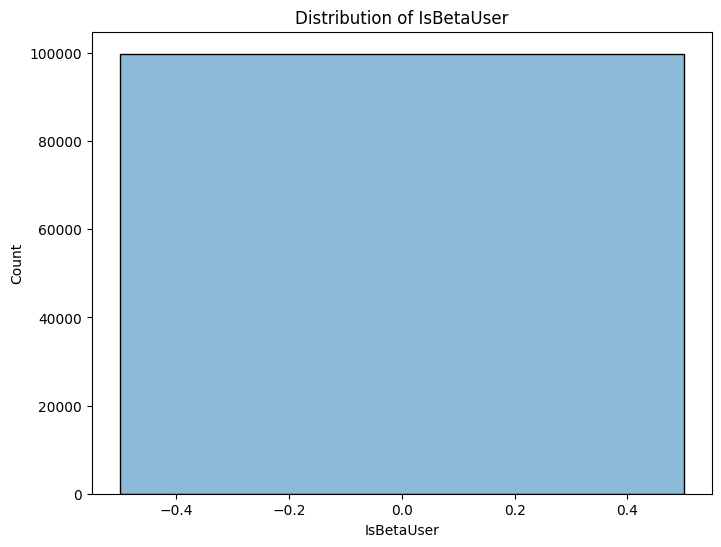

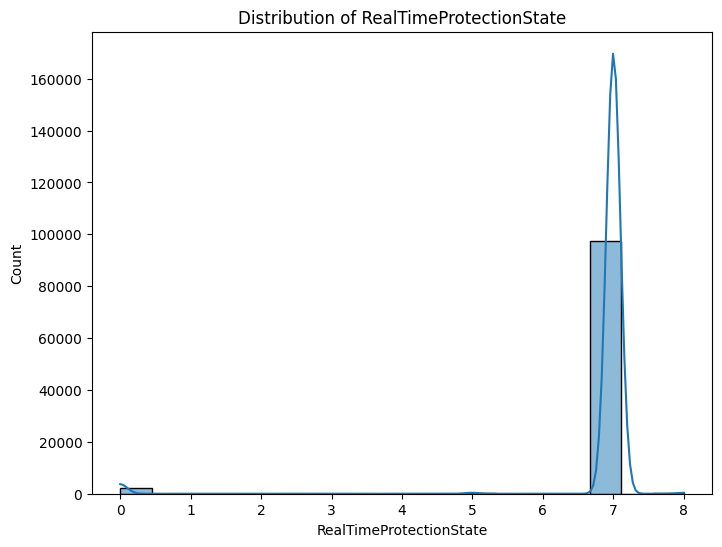

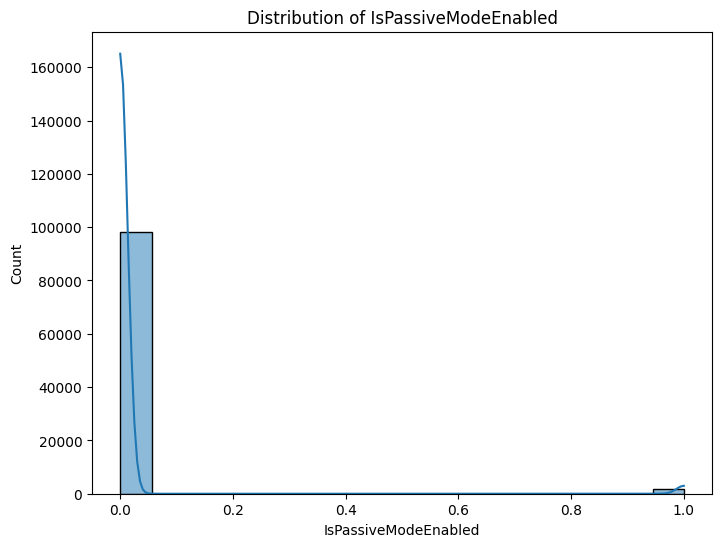

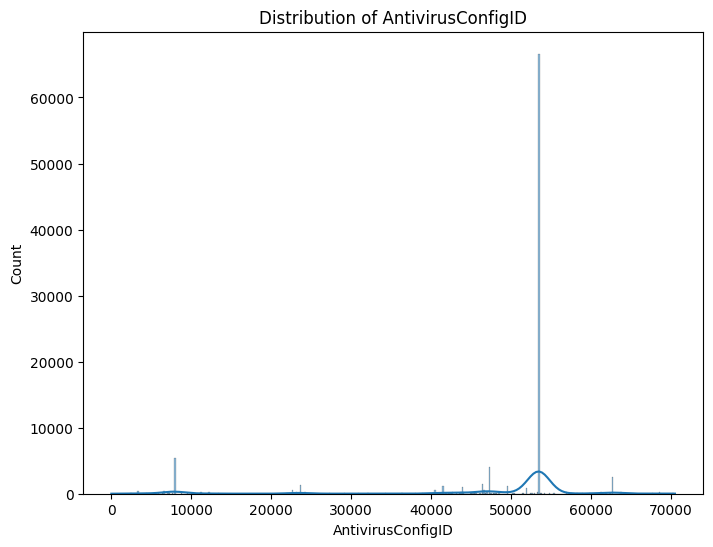

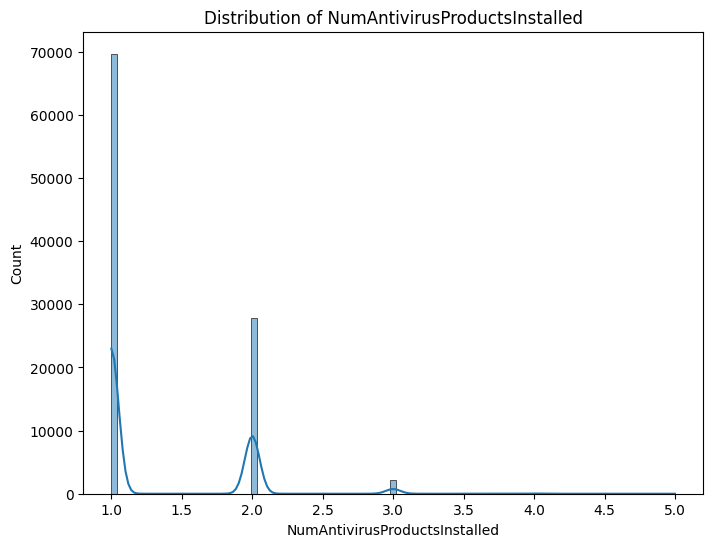

...

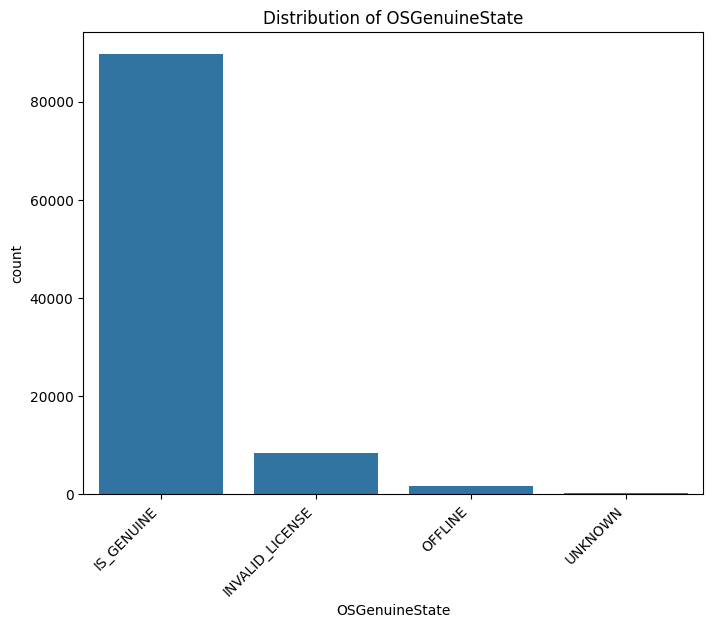

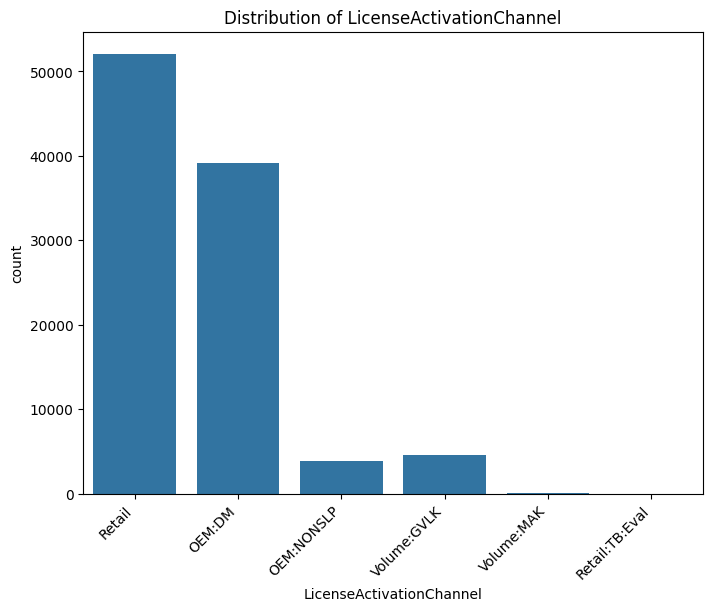

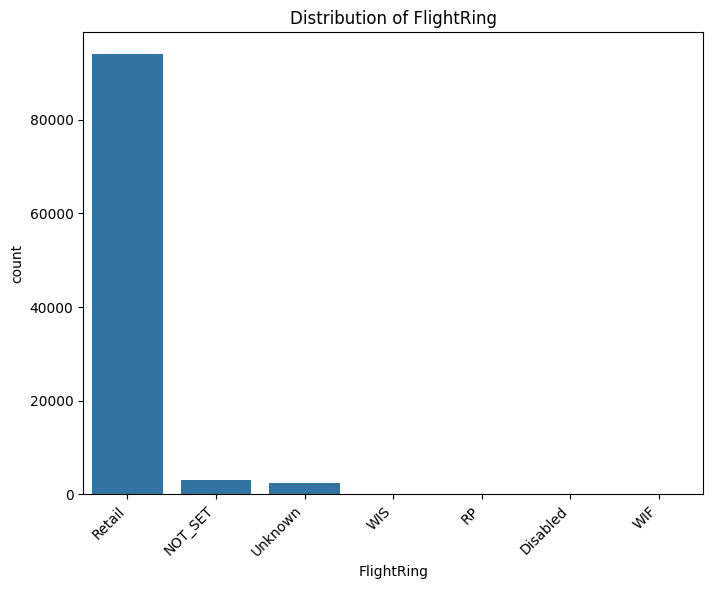

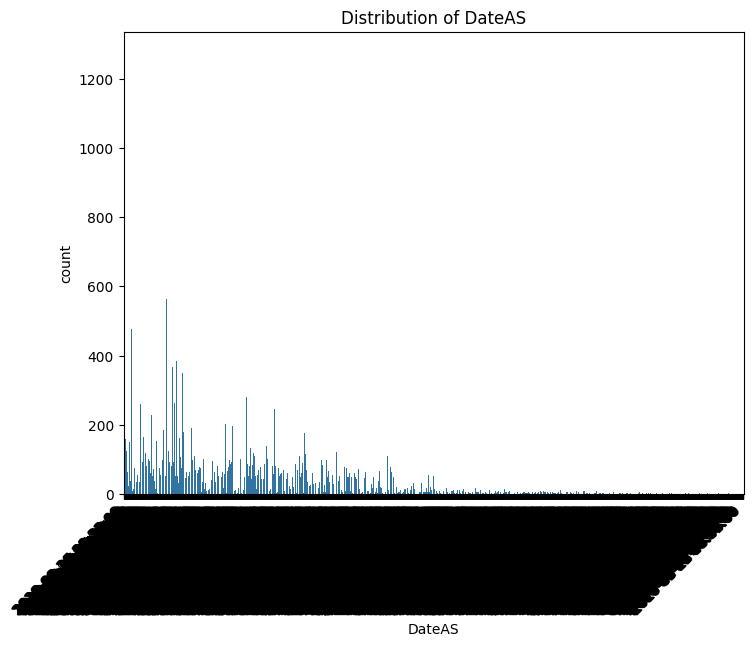

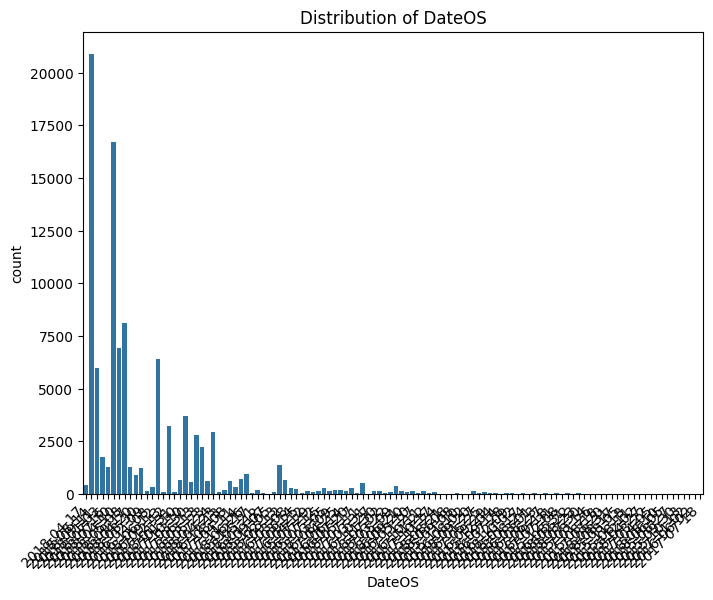

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Analyze the distribution of numerical variables
numerical_features = df_train.select_dtypes(include=['number'])
for column in numerical_features.columns:
  plt.figure(figsize=(8, 6))
  sns.histplot(df_train[column], kde=True)
  plt.title(f"Distribution of {column}")
  plt.show()

# Analyze the distribution of categorical variables
categorical_features = df_train.select_dtypes(include=['object'])
for column in categorical_features.columns:
  plt.figure(figsize=(8, 6))
  sns.countplot(x=column, data=df_train)
  plt.title(f"Distribution of {column}")
  plt.xticks(rotation=45, ha='right')
  plt.show()



In [ ]:
# prompt: extract categorical features

# Extract categorical features
categorical_features = df_train.select_dtypes(include=['object']).columns.tolist()
print(f"Categorical features: {categorical_features}")

# You can also one-hot encode categorical features if needed
# df_train = pd.get_dummies(df_train, columns=categorical_features, dummy_na=True)


Categorical features: ['MachineID', 'ProductName', 'EngineVersion', 'AppVersion', 'SignatureVersion', 'PlatformType', 'Processor', 'OSVersion', 'OsPlatformSubRelease', 'OSBuildLab', 'SKUEditionName', 'MDC2FormFactor', 'DeviceFamily', 'PrimaryDiskType', 'ChassisType', 'PowerPlatformRole', 'NumericOSVersion', 'OSArchitecture', 'OSBranch', 'OSEdition', 'OSSkuFriendlyName', 'OSInstallType', 'AutoUpdateOptionsName', 'OSGenuineState', 'LicenseActivationChannel', 'FlightRing', 'DateAS', 'DateOS']


**Reasoning**:
The previous code block failed due to the presence of non-numerical columns in the correlation matrix calculation. To address this, we will select only the numerical features for correlation analysis.



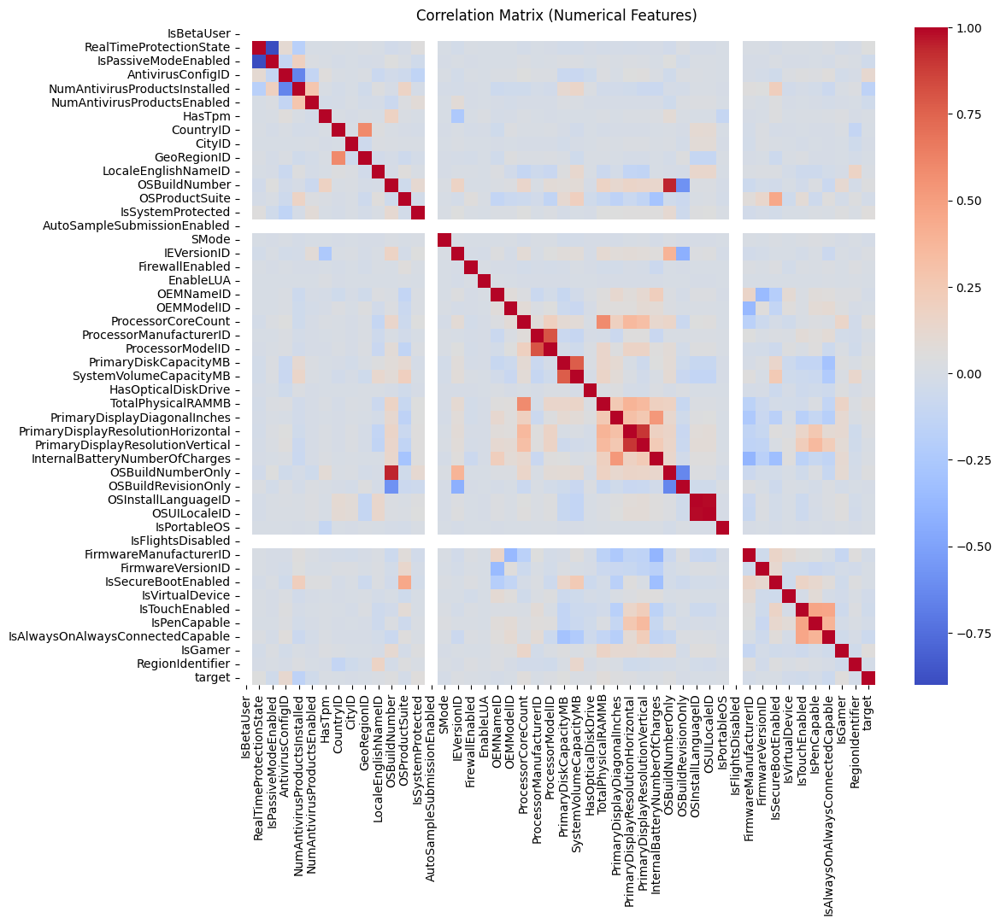

In [ ]:
# Examine correlations between variables (only numerical features)
numerical_features = df_train.select_dtypes(include=['number'])
correlation_matrix = numerical_features.corr()
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=False, cmap='coolwarm')
plt.title("Correlation Matrix (Numerical Features)")
plt.show()

## Data cleaning

### Subtask:
Clean the data by handling missing values and removing duplicate rows.


**Reasoning**:
Identify and handle missing values and remove duplicate rows in the dataframe.



In [ ]:
# Identify columns with missing values
missing_values = df_train.isnull().sum()
columns_with_missing_values = missing_values[missing_values > 0].index.tolist()

# Handle missing values
for column in columns_with_missing_values:
  if pd.api.types.is_numeric_dtype(df_train[column]):
    df_train[column].fillna(df_train[column].median(), inplace=True)
  else:
    df_train[column].fillna(df_train[column].mode()[0], inplace=True)

# Remove duplicate rows
df_train.drop_duplicates(inplace=True)

<ipython-input-5-9b20b14d3540>:8: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_train[column].fillna(df_train[column].median(), inplace=True)
<ipython-input-5-9b20b14d3540>:10: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=T

**Reasoning**:
The previous code block had a warning about chained assignment, so I will rewrite it to avoid this warning and ensure that the changes are applied to the original DataFrame.



In [ ]:
# Identify columns with missing values
missing_values = df_train.isnull().sum()
columns_with_missing_values = missing_values[missing_values > 0].index.tolist()

# Handle missing values
for column in columns_with_missing_values:
  if pd.api.types.is_numeric_dtype(df_train[column]):
    df_train[column] = df_train[column].fillna(df_train[column].median())
  else:
    df_train[column] = df_train[column].fillna(df_train[column].mode()[0])

# Remove duplicate rows
df_train.drop_duplicates(inplace=True)

## Feature engineering

### Subtask:
Engineer new features from the existing features in `df_train`.


**Reasoning**:
Create new features by interacting existing features, such as multiplying 'ProcessorCoreCount' and 'TotalPhysicalRAMMB' to capture the combined processing power. Also, create polynomial features for 'TotalPhysicalRAMMB' and 'PrimaryDiskCapacityMB' to capture non-linear relationships.



In [ ]:
# Feature Interaction: Combined Processing Power
df_train['CombinedProcessingPower'] = df_train['ProcessorCoreCount'] * df_train['TotalPhysicalRAMMB']

# Polynomial Features
df_train['TotalPhysicalRAMMB_squared'] = df_train['TotalPhysicalRAMMB'] ** 2
df_train['PrimaryDiskCapacityMB_squared'] = df_train['PrimaryDiskCapacityMB'] ** 2

# Logarithmic Transformation for RAM and Disk Capacity (handle potential zero values)
df_train['TotalPhysicalRAMMB_log'] = np.log(df_train['TotalPhysicalRAMMB'] + 1)
df_train['PrimaryDiskCapacityMB_log'] = np.log(df_train['PrimaryDiskCapacityMB'] + 1)

NameError: name 'np' is not defined

**Reasoning**:
The previous code block failed due to the missing import of numpy. Add the import and execute the code block again.



In [ ]:
import numpy as np

# Feature Interaction: Combined Processing Power
df_train['CombinedProcessingPower'] = df_train['ProcessorCoreCount'] * df_train['TotalPhysicalRAMMB']

# Polynomial Features
df_train['TotalPhysicalRAMMB_squared'] = df_train['TotalPhysicalRAMMB'] ** 2
df_train['PrimaryDiskCapacityMB_squared'] = df_train['PrimaryDiskCapacityMB'] ** 2

# Logarithmic Transformation for RAM and Disk Capacity (handle potential zero values)
df_train['TotalPhysicalRAMMB_log'] = np.log(df_train['TotalPhysicalRAMMB'] + 1)
df_train['PrimaryDiskCapacityMB_log'] = np.log(df_train['PrimaryDiskCapacityMB'] + 1)

## Data analysis

### Subtask:
Analyze the relationships between features and the target variable.


**Reasoning**:
Calculate the correlation between each feature and the target variable and identify features with high correlations.



In [ ]:
# Calculate the correlation between each feature and the target variable
correlation_with_target = df_train.corr()['target'].sort_values(ascending=False)

# Identify features with high positive or negative correlations
high_positive_correlation = correlation_with_target[correlation_with_target > 0.1]
high_negative_correlation = correlation_with_target[correlation_with_target < -0.1]

print("Features with high positive correlation:")
display(high_positive_correlation)

print("\nFeatures with high negative correlation:")
display(high_negative_correlation)

ValueError: could not convert string to float: 'f541bae429089117c4aac39c90dd3416'

**Reasoning**:
The previous code failed because it tried to calculate the correlation for all columns, including non-numerical ones. We need to select only numerical features for correlation analysis.



In [ ]:
# Select only numerical features for correlation analysis
numerical_features = df_train.select_dtypes(include=['number'])

# Calculate the correlation between numerical features and the target variable
correlation_with_target = numerical_features.corr()['target'].sort_values(ascending=False)

# Identify features with high positive or negative correlations
high_positive_correlation = correlation_with_target[correlation_with_target > 0.1]
high_negative_correlation = correlation_with_target[correlation_with_target < -0.1]

print("Features with high positive correlation:")
display(high_positive_correlation)

print("\nFeatures with high negative correlation:")
display(high_negative_correlation)

Features with high positive correlation:


,target
target,1.000000
AntivirusConfigID,0.118046



Features with high negative correlation:


,target
NumAntivirusProductsInstalled,-0.151186


**Reasoning**:
Analyze the distribution of the target variable for different values of the highly correlated features. We can do this by grouping the data by these features and calculating the mean target value for each group.




Analyzing target variable distribution for feature: AntivirusConfigID


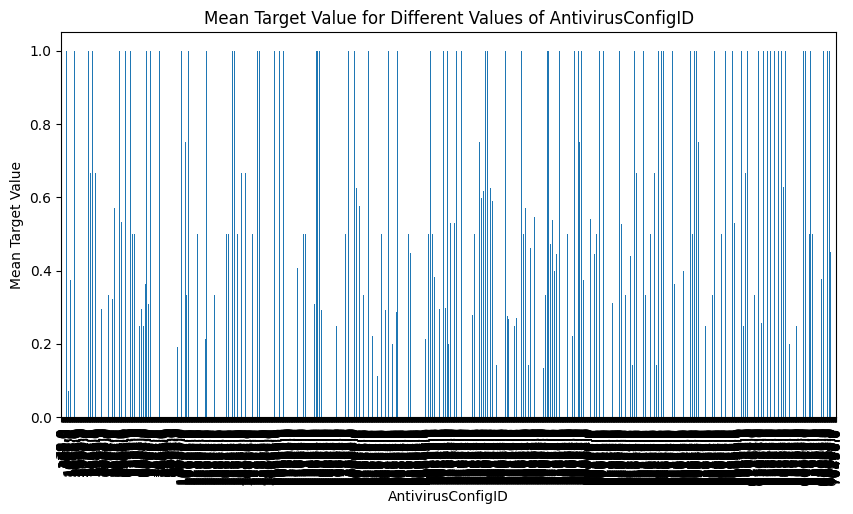


Analyzing target variable distribution for feature: NumAntivirusProductsInstalled


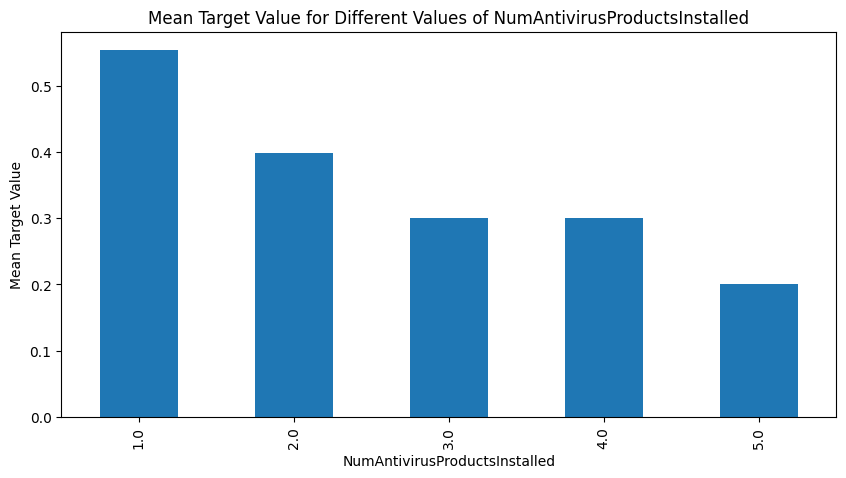

In [ ]:
import matplotlib.pyplot as plt

# Analyze the distribution of the target variable for different values of the highly correlated features
for feature in ['AntivirusConfigID', 'NumAntivirusProductsInstalled']:
    print(f"\nAnalyzing target variable distribution for feature: {feature}")
    df_train.groupby(feature)['target'].mean().plot(kind='bar', figsize=(10, 5))
    plt.title(f"Mean Target Value for Different Values of {feature}")
    plt.xlabel(feature)
    plt.ylabel("Mean Target Value")
    plt.show()


**Reasoning**:
The current analysis shows that the mean target value varies for different values of the identified features. Now we can create scatter plots to visualize the relationship between these features and the target variable.



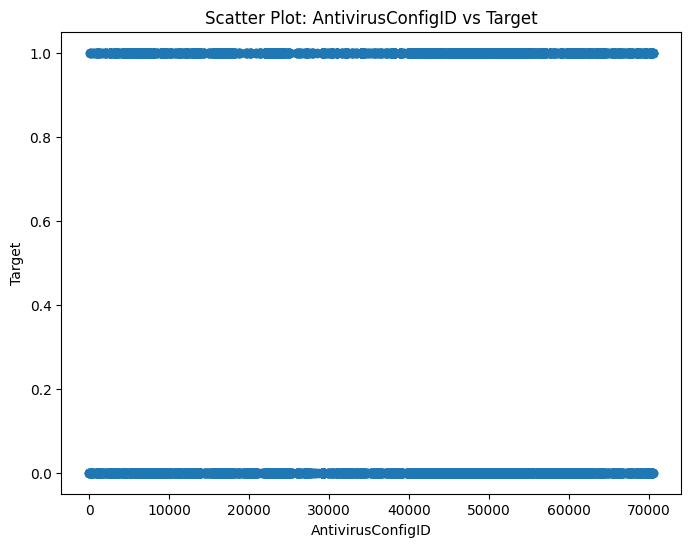

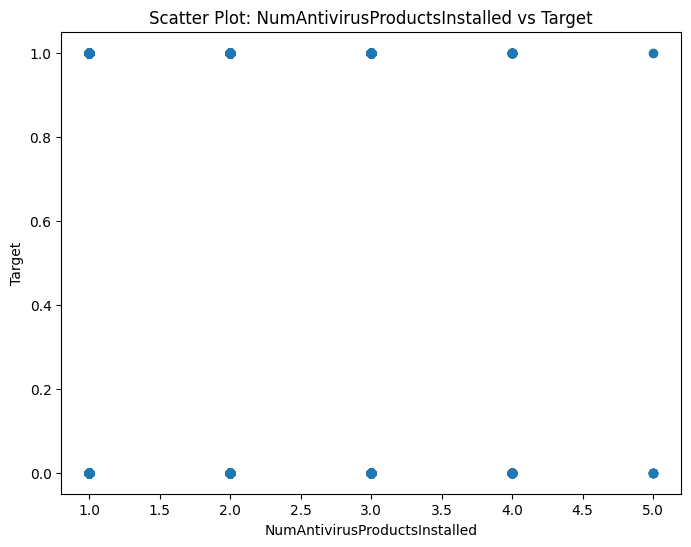

In [ ]:
import matplotlib.pyplot as plt

# Create scatter plots to visualize the relationship between features and target
for feature in ['AntivirusConfigID', 'NumAntivirusProductsInstalled']:
    plt.figure(figsize=(8, 6))
    plt.scatter(df_train[feature], df_train['target'])
    plt.title(f"Scatter Plot: {feature} vs Target")
    plt.xlabel(feature)
    plt.ylabel("Target")
    plt.show()

## Data visualization

### Subtask:
Visualize the relationships between features and the target variable using appropriate charts.


**Reasoning**:
Create histograms for numerical features to understand their distributions and generate box plots to compare the distributions of numerical features across different target variable classes.



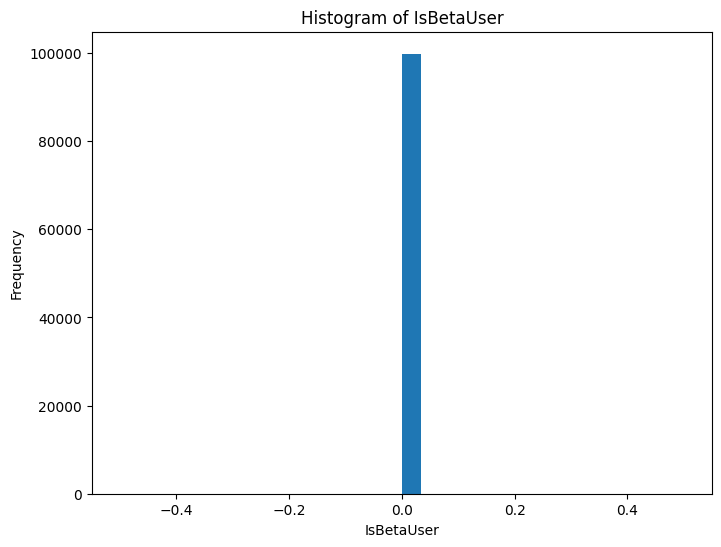

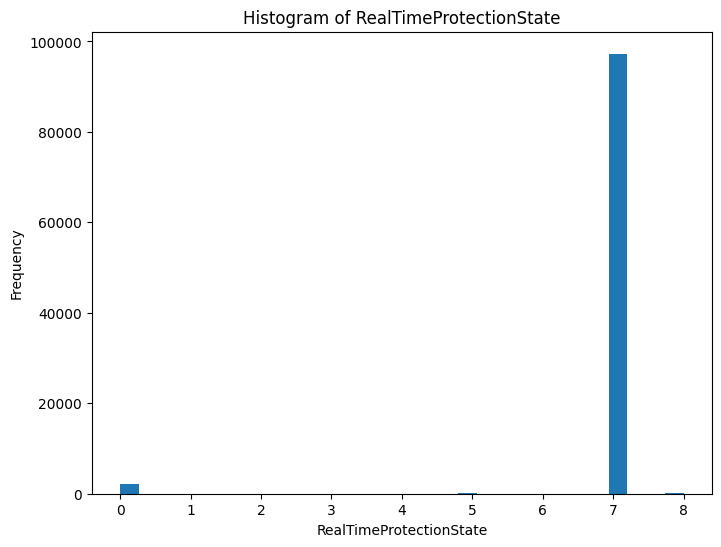

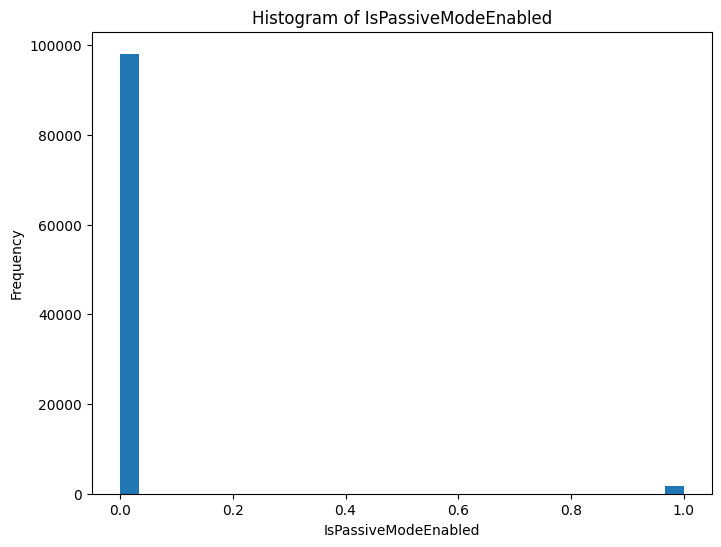

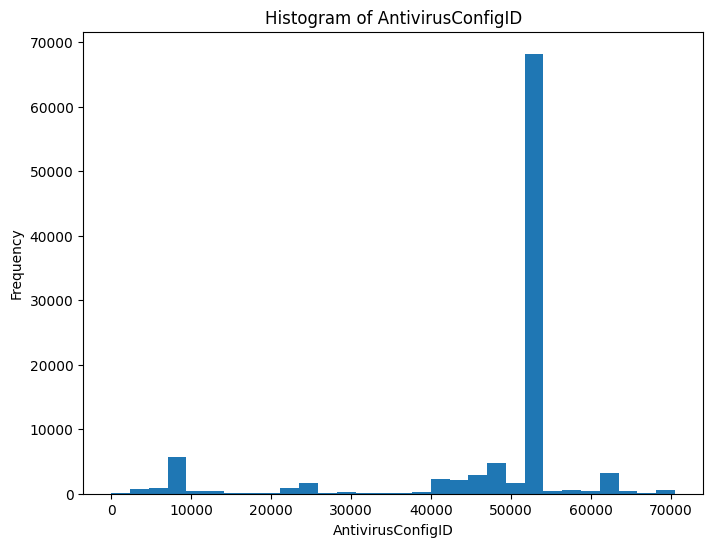

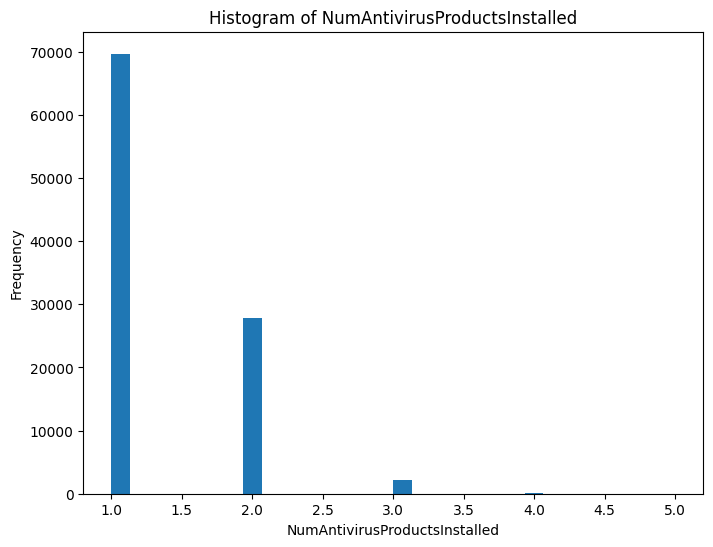

...

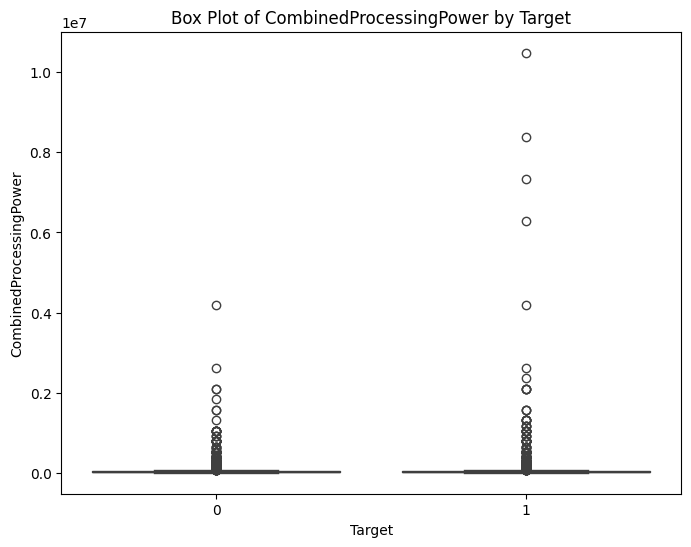

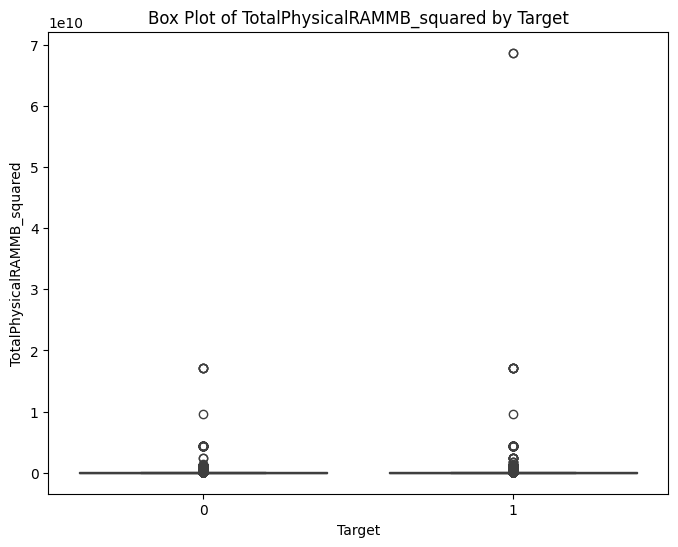

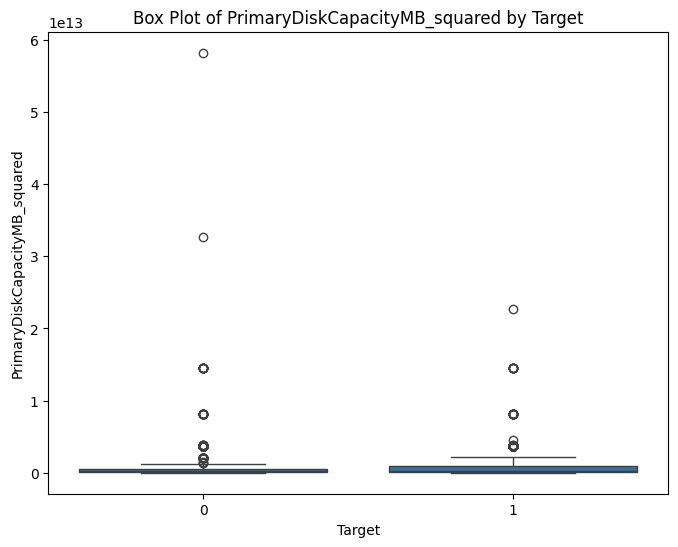

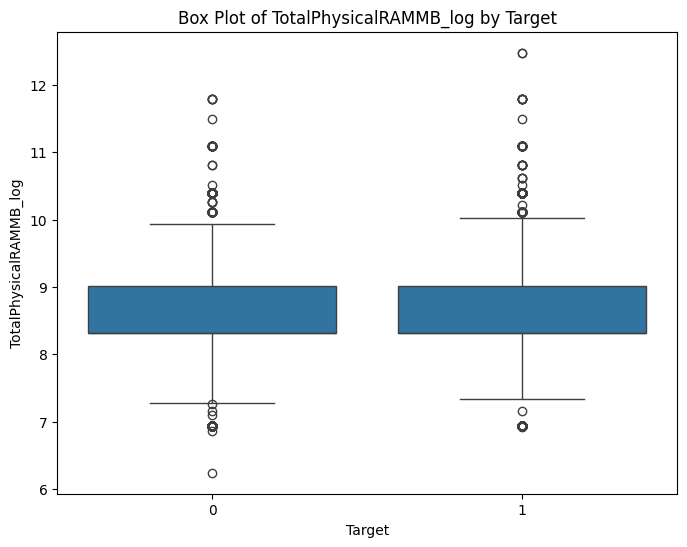

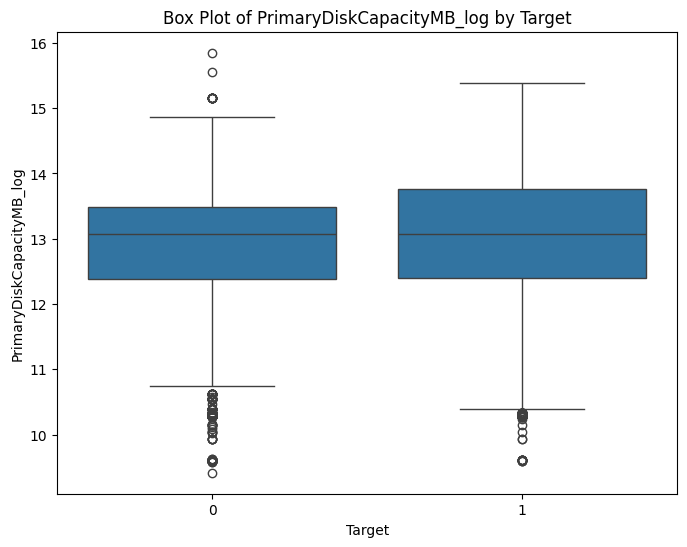

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Select numerical features
numerical_features = df_train.select_dtypes(include=['number'])

# Create histograms for numerical features
for feature in numerical_features.columns:
  plt.figure(figsize=(8, 6))
  plt.hist(df_train[feature], bins=30)
  plt.title(f"Histogram of {feature}")
  plt.xlabel(feature)
  plt.ylabel("Frequency")
  plt.show()

# Generate box plots to compare distributions across target classes
for feature in numerical_features.columns:
  plt.figure(figsize=(8, 6))
  sns.boxplot(x='target', y=feature, data=df_train)
  plt.title(f"Box Plot of {feature} by Target")
  plt.xlabel("Target")
  plt.ylabel(feature)
  plt.show()

**Reasoning**:
Create scatter plots to visualize the relationships between pairs of features and the target variable, and for categorical features, create bar charts showing the distribution of the target variable within each category.



/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


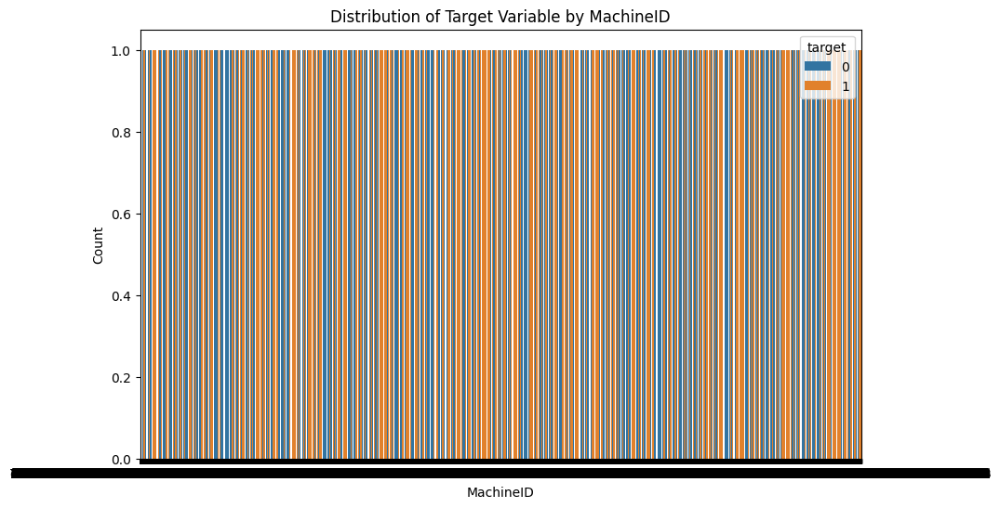

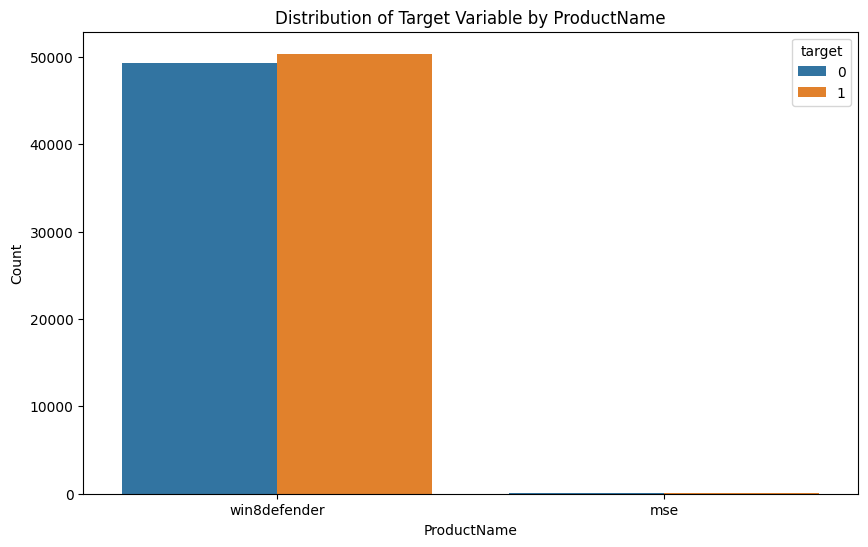

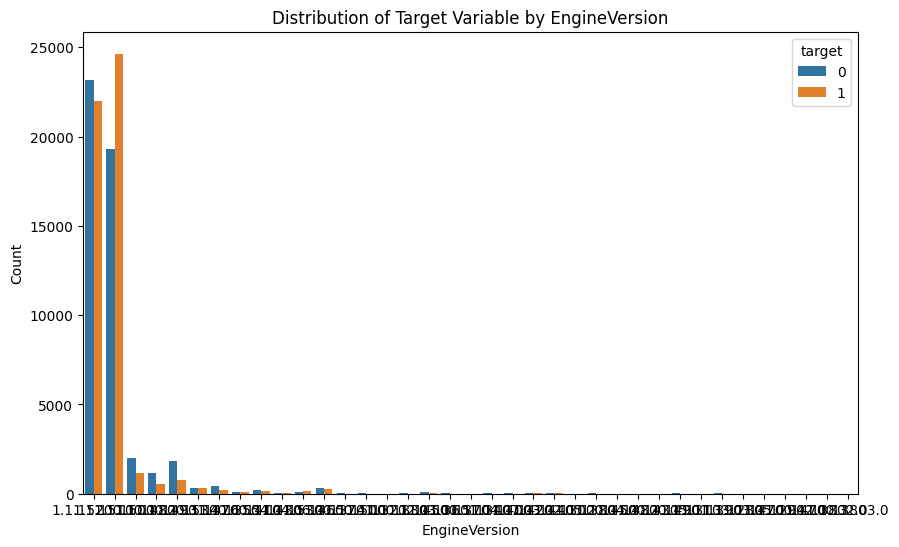

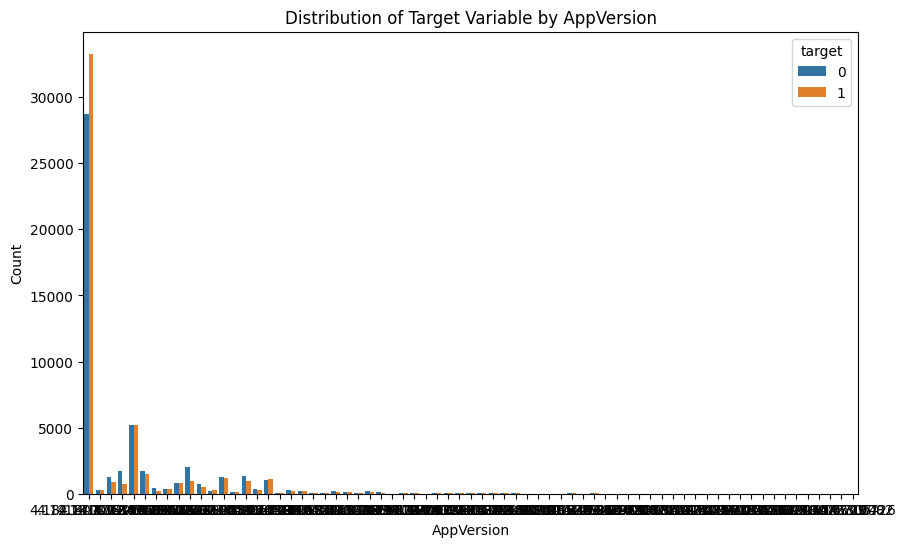

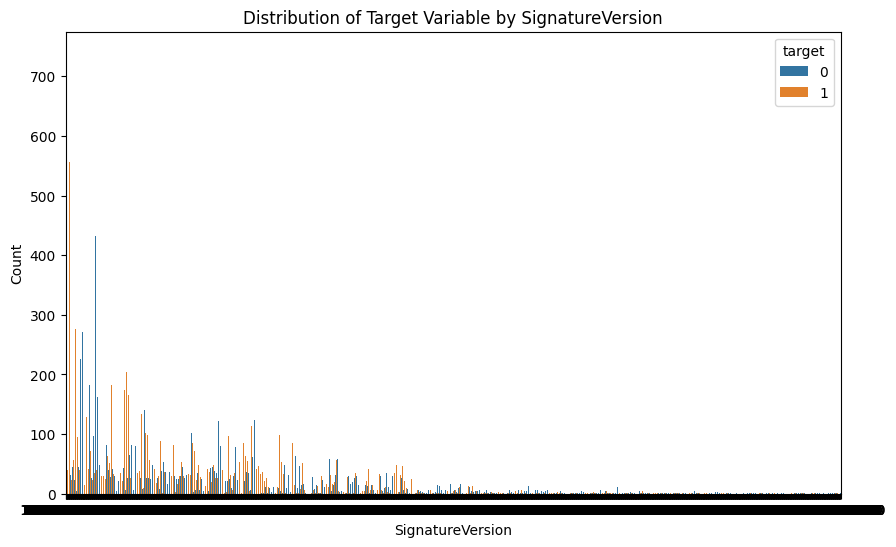

...

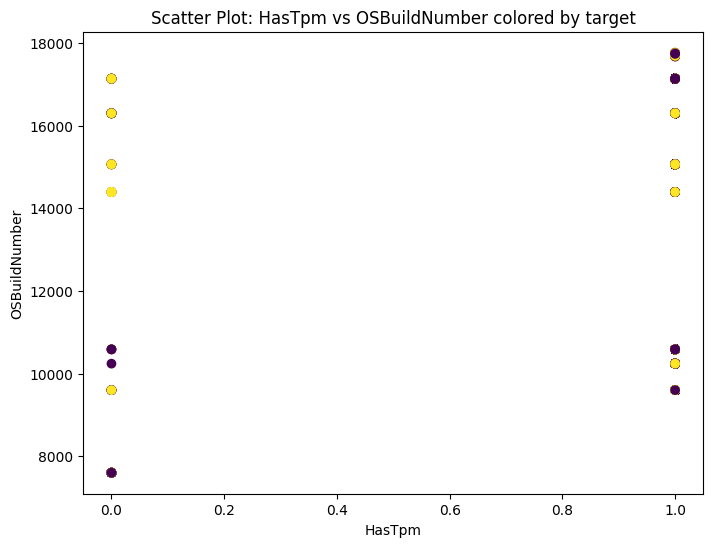

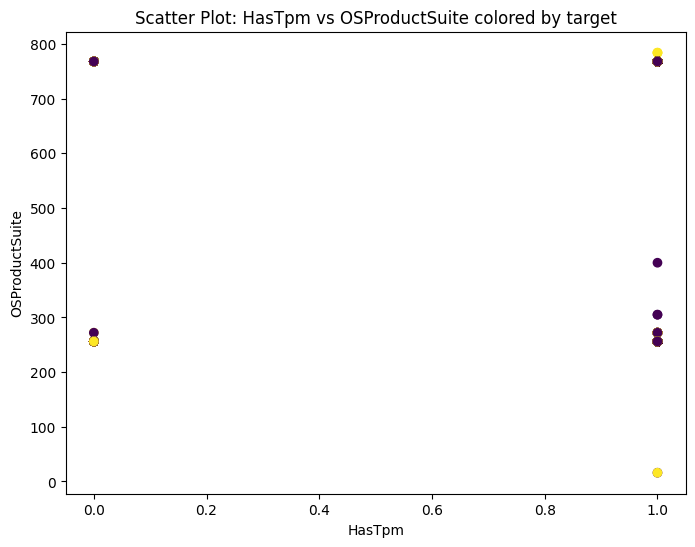

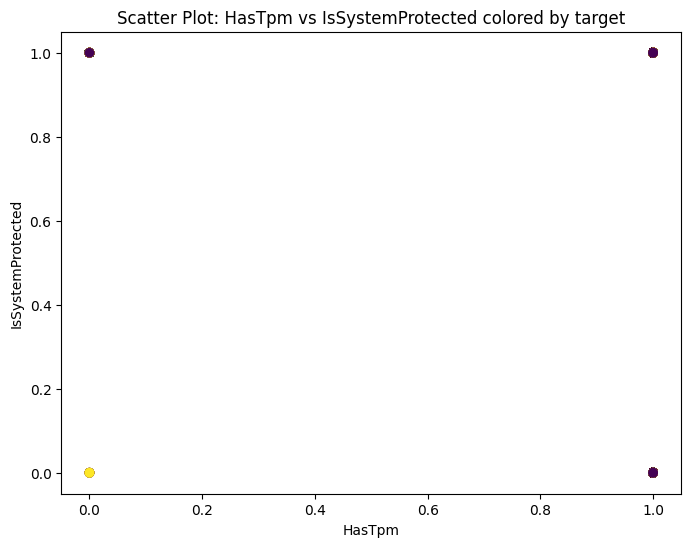

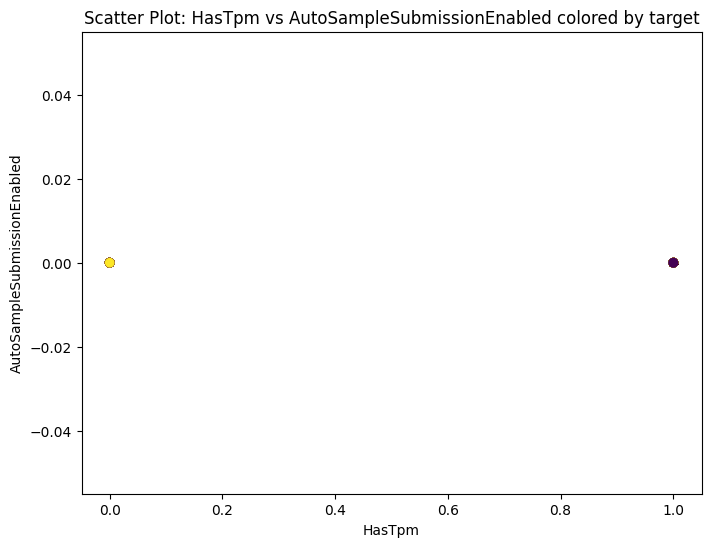

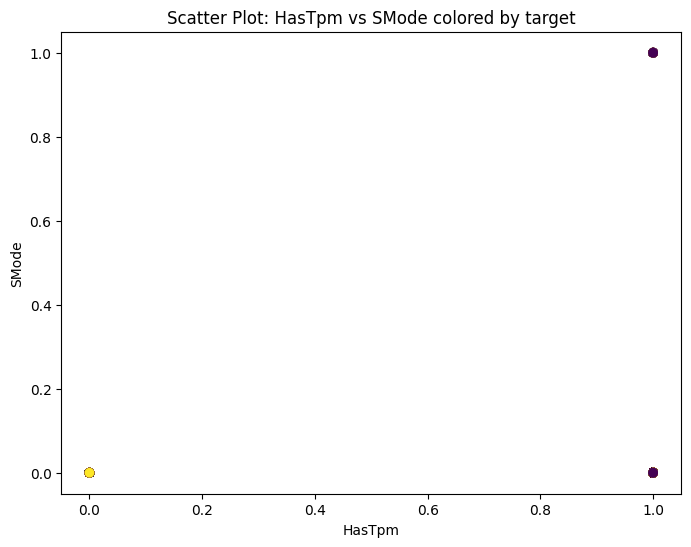

KeyboardInterrupt: 

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Select categorical features
categorical_features = df_train.select_dtypes(include=['object'])

# Create bar charts for categorical features
for feature in categorical_features.columns:
  plt.figure(figsize=(10, 6))
  sns.countplot(x=feature, hue='target', data=df_train)
  plt.title(f"Distribution of Target Variable by {feature}")
  plt.xlabel(feature)
  plt.ylabel("Count")
  plt.show()

# Create scatter plots for pairs of features and the target variable
for feature1 in numerical_features.columns:
  for feature2 in numerical_features.columns:
    if feature1 != feature2 and feature1 != 'target' and feature2 != 'target':
      plt.figure(figsize=(8, 6))
      plt.scatter(df_train[feature1], df_train[feature2], c=df_train['target'])
      plt.title(f"Scatter Plot: {feature1} vs {feature2} colored by target")
      plt.xlabel(feature1)
      plt.ylabel(feature2)
      plt.show()